# Notebook 1: Capstone Project - Instacart 

## Problem Statement

Instacart being a grocery delivery and pick-up service, offers its services through the website and mobile app. Being an e-commerce business especially now, during the Covid period, it is important to maintain user experience and ease in finding products on their online store. As a data analyst with Instacart, it has come to our attention that there are quite a lot of missing information of which department and aisles a product belongs to. As products are categorized into departments, users could search for products by departments. With missing departments, those products would not appear if users were to search by department. To solve this problem, we will build a model that would automatically take the product name and map them to their most likely department which would ensure all items are mapped to their most closely related department. This would not only ease users search for items and prevent any omission of products if users search by departments, which may result in higher sales as well, it would give a more complete and organized inventory and help make reporting more efficient, complete and accurate, for example, reporting the department-wise sales. 

## Executive Summary

The goal is to help find solutions using data to predict which product goes to which department automatically. This would help not only more efficient inventory management, it would also help reporting to be more efficient and accurate by preventing any ommission of data. For example, when looking at the department-wise revenue.

The data gathered for this project is from [Kaggle](https://www.kaggle.com/c/instacart-market-basket-analysis/data). The data is from an American company that operates a grocery delivery and pick-up service in the United States and Canada and consists of:
* All the Product Name and ID
* Aisle Name and ID corresponding to its product
* Department Name and ID corresponding to its product

The data from the 3 sets mentioned above were cleaned and combined together to form the full dataset called "products_df" for more EDA and analysis and ultimately modelling. 

From the vast data collection, missing departments and aisles were found for some products. Since Instacart is known for their e-commerce business, this could mean that users who were to search by department for products to buy, may never get the opportunity to see these products as one of their choices, which would then affect sales on these products. This is assuming that these data would feed into the algorithm of their website and mobile app. Building a model that would map the product to its department automatically and as accurately as possible, might improve user experience and sales. The target variable "department" was chosen as the product names in each aisle were too similar, which is a limitation to help in accurate predictions.

The product name was used as features to predict which department a product would be in. They were preprocessed, extracted to form the vocabulary and fitted into the model. 

Preprocessing steps:
* Removal of stop words
* Removal of punctuations and special characters
* Lemmatization
* Train_test_split

Gridsearching was done with a combination of feature extraction steps: 
* CountVectorizer
* TfifdVectorizer
* Doc2Vec

and modeling:
* Logistic Regression
* MultinomialNaiveBayes
* Transfer Learning - RNN(LSTM)

Different Vectorizers were used to see how well the model could see order and frequency and count of each word would be in the prediction of products and its departments. Logistic Regression was chosen as it was a simple and effective model which could be used as benchmark to other models. Each hyperparameters were tuned for its feature extraction and modelling steps. Gridsearch with 5 Cross-validations was done to get the best "macro-average" F1score, precision and recall. The production model was chosen by comparing the train and validation scores between models.


The production model choses what the Logistic Regression model with count vectorized features. There were about 216,000 features after vectorizing, we used the count vectorizer of max features 80,000 to fit into the model. The model may have been slightly overfitted with the train accuracy at 0.97 and test at 0.84. However it had the highest F1-score which was our main metric for measuring the performance of our models. Looking at the confusion matrix was another method for choosing the model. Most of the confusion matrix had similar results, except for all the Doc2Vec features that were fitted, where most of the classes were predicted correctly. I would recommend to first implement a simple model, and looking at how the model performs and whether there was improved sales especially for those products that were missing initially, and from there we could probably fine-tune the model more, build a recommender system to recommend products that are similar to those the customer tends to buy or even build a model to categorize products by aisles(subcategory to department) to help filter items better, if we see that the model helps improve sales for products especially those initially with missing departments.

### Contents:
- [Data Dictionary](#Data-Dictionary)
- [Data munging & initial EDA](#Data-munging-and-initial-EDA)
- [Initial Data Preprocessing](#Initial-Preprocessing)
- [Comparison of products between classes](#Comparison-of-products-between-classes)

## Data Dictionary

|<div style="text-align: left">Feature</div>|Type|Dataset|<div style="text-align: left">Description</div>|
|---|---|---|---|
|<div style="text-align: left">**product_name_words**</div>|<div style="text-align: left">*object*</div>|<div style="text-align: left">products_df</div>|<div style="text-align: left">Cleaned words of each product name</div>|
|<div style="text-align: left">**department_id**</div>|<div style="text-align: left">*integer*</div>|<div style="text-align: left">products_df</div>|<div style="text-align: left">All 21 IDs of each department and the target classes</div>|
|<div style="text-align: left">**department_name**</div>|<div style="text-align: left">*object*</div>|<div style="text-align: left">products_df</div>|<div style="text-align: left">All the 21 department names which would be used to label the confusion matrix for better visualization</div>|

In [2]:
#import all the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
import plotly
import plotly.express as px
import re
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from wordcloud import WordCloud

from pandas_profiling import ProfileReport as pfr

%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)



## Data munging and initial EDA

### Cleaning and initial EDA of aisle data

In [3]:
# read the zip file of aisle
aisles = zipfile.ZipFile('../datasets/aisles.csv.zip')
aisles = pd.read_csv(aisles.open('aisles.csv'))

In [4]:
pfr(aisles)

Summarize dataset:   0%|          | 0/15 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
print(aisles.shape)
# check that there are not duplicates
print(aisles['aisle_id'].nunique())
print(aisles['aisle'].nunique())
aisles.head()

(134, 2)
134
134


,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation


In [6]:
# display all the unique values of aisles
aisles['aisle'].unique() 

array(['prepared soups salads', 'specialty cheeses',
       'energy granola bars', 'instant foods',
       'marinades meat preparation', 'other', 'packaged meat',
       'bakery desserts', 'pasta sauce', 'kitchen supplies',
       'cold flu allergy', 'fresh pasta', 'prepared meals',
       'tofu meat alternatives', 'packaged seafood', 'fresh herbs',
       'baking ingredients', 'bulk dried fruits vegetables',
       'oils vinegars', 'oral hygiene', 'packaged cheese', 'hair care',
       'popcorn jerky', 'fresh fruits', 'soap', 'coffee', 'beers coolers',
       'red wines', 'honeys syrups nectars', 'latino foods',
       'refrigerated', 'packaged produce', 'kosher foods',
       'frozen meat seafood', 'poultry counter', 'butter',
       'ice cream ice', 'frozen meals', 'seafood counter',
       'dog food care', 'cat food care', 'frozen vegan vegetarian',
       'buns rolls', 'eye ear care', 'candy chocolate', 'mint gum',
       'vitamins supplements', 'breakfast bars pastries',
       '

In [7]:
aisles.isnull().sum()

aisle_id    0
aisle       0
dtype: int64

In [8]:
aisles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134 entries, 0 to 133
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   aisle_id  134 non-null    int64 
 1   aisle     134 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.2+ KB


### Cleaning and initial EDA of departments data

In [9]:
# read the zip file of departments
departments = zipfile.ZipFile('../datasets/departments.csv.zip')
departments = pd.read_csv(departments.open('departments.csv'))

In [10]:
print(departments.shape)
# check that there are not duplicates
print(departments['department_id'].nunique())
print(departments['department'].nunique())
departments.head()

(21, 2)
21
21


,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol


In [11]:
# display all the unique values of departments
departments['department'].unique()

array(['frozen', 'other', 'bakery', 'produce', 'alcohol', 'international',
       'beverages', 'pets', 'dry goods pasta', 'bulk', 'personal care',
       'meat seafood', 'pantry', 'breakfast', 'canned goods',
       'dairy eggs', 'household', 'babies', 'snacks', 'deli', 'missing'],
      dtype=object)

There is a department called missing, we will take a look at this later on.

In [12]:
#find the department id for the department called missing
departments[departments['department']=='missing']

,department_id,department
20,21,missing


In [13]:
departments.isnull().sum()

department_id    0
department       0
dtype: int64

In [14]:
departments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   department_id  21 non-null     int64 
 1   department     21 non-null     object
dtypes: int64(1), object(1)
memory usage: 464.0+ bytes


### Cleaning and initial EDA of products data

In [15]:
### Cleaning and initial EDA of aisle dataproducts = zipfile.ZipFile('datasets/products.csv.zip') 
products = zipfile.ZipFile('../datasets/products.csv.zip')
products = pd.read_csv(products.open('products.csv'))

In [16]:
print(products.shape)
# check that there are not duplicates
print(products['product_id'].nunique())
print(products['product_name'].nunique())
products.head()

(49688, 4)
49688
49688


,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13


In [17]:
products.isnull().sum()

product_id       0
product_name     0
aisle_id         0
department_id    0
dtype: int64

In [18]:
# check the products that are at "missing" department ID 21
products[products['department_id']==21]

,product_id,product_name,aisle_id,department_id
37,38,Ultra Antibacterial Dish Liquid,100,21
71,72,Organic Honeycrisp Apples,100,21
109,110,Uncured Turkey Bologna,100,21
296,297,"Write Bros Ball Point Pens, Cap-Pen, Medium (1...",100,21
416,417,Classics Baby Binks Easter Chocolate Bunny,100,21
436,437,Strawberry Cheesecake Nonfat Yogurt,100,21
439,440,Crossovers Olive Thyme Almond,100,21
471,472,Fancy Diced Hot Chilies,100,21
490,491,Pompelmo Water,100,21
555,556,Bake & Break Cheese Garlic Loaf,100,21


All aisle id mapped to department id 21 are also named "missing".

In [19]:
aisles[aisles['aisle_id']==100]

,aisle_id,aisle
99,100,missing


In [20]:
products[products['aisle_id']==100]

,product_id,product_name,aisle_id,department_id
37,38,Ultra Antibacterial Dish Liquid,100,21
71,72,Organic Honeycrisp Apples,100,21
109,110,Uncured Turkey Bologna,100,21
296,297,"Write Bros Ball Point Pens, Cap-Pen, Medium (1...",100,21
416,417,Classics Baby Binks Easter Chocolate Bunny,100,21
436,437,Strawberry Cheesecake Nonfat Yogurt,100,21
439,440,Crossovers Olive Thyme Almond,100,21
471,472,Fancy Diced Hot Chilies,100,21
490,491,Pompelmo Water,100,21
555,556,Bake & Break Cheese Garlic Loaf,100,21


There are 1258 products that are not mapped to any aisle and departments.

In [21]:
products[products['department_id']==21]['aisle_id'].value_counts()

100    1258
Name: aisle_id, dtype: int64

In [22]:
products[products['aisle_id']==100]['department_id'].value_counts()

21    1258
Name: department_id, dtype: int64

We can see that those with missing department_id has missing aisle_id. The other data seems complete except for these.

In [23]:
products.describe()

,product_id,aisle_id,department_id
count,49688.000000,49688.000000,49688.000000
mean,24844.500000,67.769582,11.728687
std,14343.834425,38.316162,5.850410
min,1.000000,1.000000,1.000000
25%,12422.750000,35.000000,7.000000
50%,24844.500000,69.000000,13.000000
75%,37266.250000,100.000000,17.000000
max,49688.000000,134.000000,21.000000


Automating to map the products to its aisles and department would help to make it more efficient in identifying which products are in which aisles, which in turn would help to better place products to monitor which products are not selling well and to boost sales for those under-performing products. Automating this would also improve efficiency of stock management.

In [24]:
# merging aisles to products
products_df = pd.merge(left=products,right=aisles, on='aisle_id', how='left')

In [25]:
# merging departments to products
products_df = pd.merge(left=products_df,right=departments, on='department_id', how='left')

In [26]:
print(products_df.shape)
products_df.head()

(49688, 6)


,product_id,product_name,aisle_id,department_id,aisle,department
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks
1,2,All-Seasons Salt,104,13,spices seasonings,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,7,tea,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen meals,frozen
4,5,Green Chile Anytime Sauce,5,13,marinades meat preparation,pantry


In [27]:
# rearranging the columns for better viewing
products_df = products_df[['product_id','product_name','aisle_id','aisle','department_id','department']]
products_df.head()

,product_id,product_name,aisle_id,aisle,department_id,department
0,1,Chocolate Sandwich Cookies,61,cookies cakes,19,snacks
1,2,All-Seasons Salt,104,spices seasonings,13,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,tea,7,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,frozen meals,1,frozen
4,5,Green Chile Anytime Sauce,5,marinades meat preparation,13,pantry


In [28]:
# rename the columns for better identification
products_df.columns = ['product_id','product_name','aisle_id','aisle_name','department_id','department_name']
products_df.head()

,product_id,product_name,aisle_id,aisle_name,department_id,department_name
0,1,Chocolate Sandwich Cookies,61,cookies cakes,19,snacks
1,2,All-Seasons Salt,104,spices seasonings,13,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,tea,7,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,frozen meals,1,frozen
4,5,Green Chile Anytime Sauce,5,marinades meat preparation,13,pantry


In [29]:
products_df['length_product_name'] = [len(x) for x in products_df['product_name'].str.split(' ')]
products_df.head(10)

,product_id,product_name,aisle_id,aisle_name,department_id,department_name,length_product_name
0,1,Chocolate Sandwich Cookies,61,cookies cakes,19,snacks,3
1,2,All-Seasons Salt,104,spices seasonings,13,pantry,2
2,3,Robust Golden Unsweetened Oolong Tea,94,tea,7,beverages,5
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,frozen meals,1,frozen,10
4,5,Green Chile Anytime Sauce,5,marinades meat preparation,13,pantry,4
5,6,Dry Nose Oil,11,cold flu allergy,11,personal care,3
6,7,Pure Coconut Water With Orange,98,juice nectars,7,beverages,5
7,8,Cut Russet Potatoes Steam N' Mash,116,frozen produce,1,frozen,6
8,9,Light Strawberry Blueberry Yogurt,120,yogurt,16,dairy eggs,4
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,water seltzer sparkling water,7,beverages,7


In [30]:
products_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49688 entries, 0 to 49687
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   product_id           49688 non-null  int64 
 1   product_name         49688 non-null  object
 2   aisle_id             49688 non-null  int64 
 3   aisle_name           49688 non-null  object
 4   department_id        49688 non-null  int64 
 5   department_name      49688 non-null  object
 6   length_product_name  49688 non-null  int64 
dtypes: int64(4), object(3)
memory usage: 3.0+ MB


The distribution of the length of words for product name is skewed to the right. This means most of the product names have lengths that are short. As can be seen in the histogram below that most of the product names are between the length of 3 to 9 with a mean of about 5.

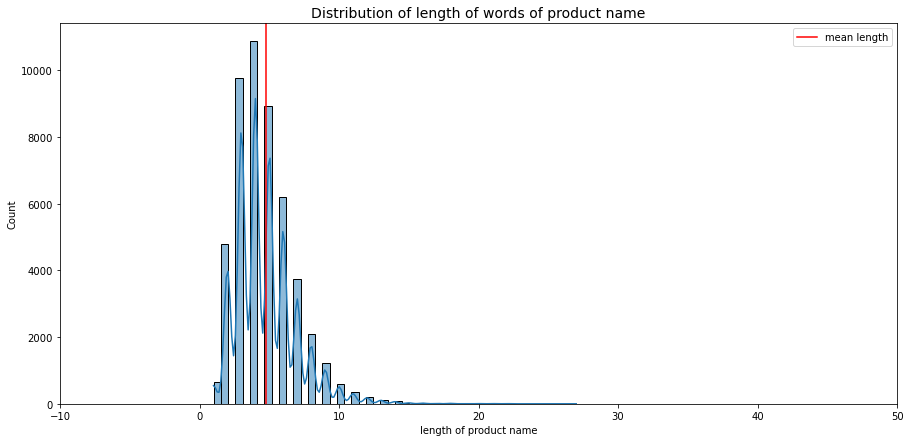

In [31]:
plt.figure(figsize=(15,7))
sns.histplot(products_df['length_product_name'], bins=50, kde=True)
plt.axvline((products_df['length_product_name']).mean(), c='r', label='mean length')
plt.xlabel('length of product name')
plt.xlim(-10,50)
plt.title('Distribution of length of words of product name', fontsize=14)
plt.legend()
plt.show();

In [32]:
#grouped to get the number of products in each aisle for each department
aisle_group = products_df.groupby(['department_name','aisle_name'])['product_name'].count()
aisle_group

department_name  aisle_name                   
alcohol          beers coolers                     385
                 red wines                         232
                 specialty wines champagnes         95
                 spirits                           195
                 white wines                       147
babies           baby accessories                   44
                 baby bath body care               132
                 baby food formula                 718
                 diapers wipes                     187
bakery           bakery desserts                   297
                 bread                             557
                 breakfast bakery                  226
                 buns rolls                        195
                 tortillas flat bread              241
beverages        cocoa drink mixes                 223
                 coffee                            680
                 energy sports drinks              294
                 j

In [33]:
#masking to see one department in the groupby df (aisle_group)
df1 = aisle_group.reset_index()
df1[df1['department_name']=='alcohol']

,department_name,aisle_name,product_name
0,alcohol,beers coolers,385
1,alcohol,red wines,232
2,alcohol,specialty wines champagnes,95
3,alcohol,spirits,195
4,alcohol,white wines,147


In [34]:
# getting the indexed columns to enumerate through
checks_by_dept = products_df['department_name'].value_counts()
dept_names = checks_by_dept.index
dept_names

Index(['personal care', 'snacks', 'pantry', 'beverages', 'frozen',
       'dairy eggs', 'household', 'canned goods', 'dry goods pasta', 'produce',
       'bakery', 'deli', 'missing', 'international', 'breakfast', 'babies',
       'alcohol', 'pets', 'meat seafood', 'other', 'bulk'],
      dtype='object')

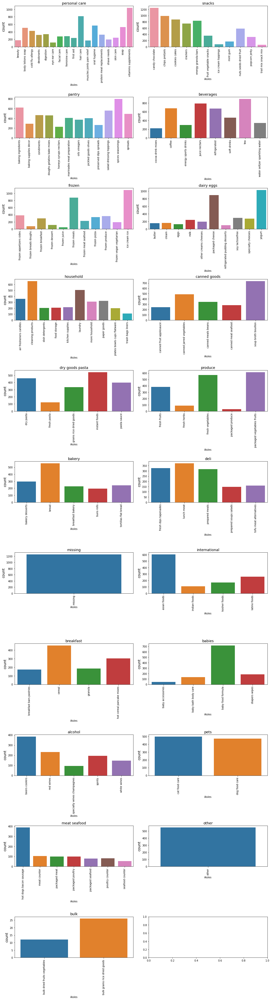

In [35]:
# plotting to show in each department the aisles in the department and number of products in each department
fig, ax = plt.subplots(nrows=11, ncols=2,figsize=(15, 11*5)) 
ax = ax.ravel() 
for i, column in enumerate(dept_names): 
    temp_df = df1[df1['department_name'] == column]
    sns.barplot(x = temp_df['aisle_name'], y = temp_df['product_name'], ax = ax[i])
    ax[i].set_title(column,fontsize=14)  
    ax[i].set_xlabel('Aisles', fontsize=10)
    ax[i].set_ylabel('count', fontsize=14)
    #ax[i].tick_params(labelrotation=90)
    for tick in ax[i].get_xticklabels():
        tick.set_rotation(90)
plt.tight_layout()

The number of products in each department varies a lot and is imbalanced. However most of the of the departments have at least about 1000 or more products in them which should be sufficient to train the model. Those that have lesser, for example the "bulk" and "others" department have 2 and 1 aisles respectively, which makes sense why they have lesser products. We could combine bulk into others since they only have 2 aisles in them and would be easy to differentiate.

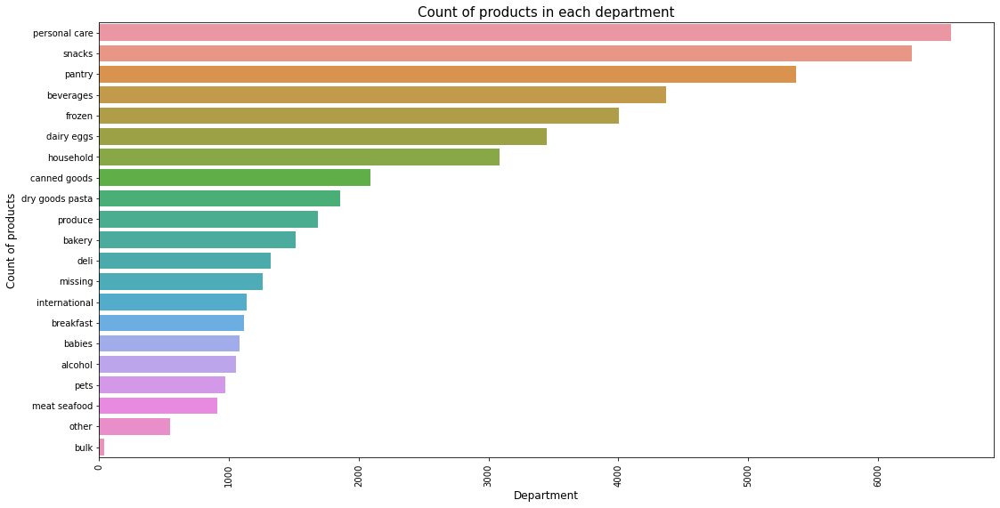

In [36]:
#checking to see which department the number of products in each department
plt.figure(figsize=(18,9))
sns.countplot(y='department_name', data=products_df, order = products_df['department_name'].value_counts().index)
plt.xticks(rotation=90)
plt.title("Count of products in each department", fontsize=15)
plt.tick_params(labelsize=10)
plt.xlabel("Department",fontsize=12)
plt.ylabel("Count of products",fontsize=12)
plt.show;

In [37]:
products_df[(products_df['department_name']=='bulk') | (products_df['department_name']=='other')]

,product_id,product_name,aisle_id,aisle_name,department_id,department_name,length_product_name
85,86,"Camilia, Single Liquid Doses",6,other,2,other,4
502,503,Wild Rice Blend,68,bulk grains rice dried goods,10,bulk,3
505,506,Arrowroot Powder,6,other,2,other,2
534,535,Rescue Remedy,6,other,2,other,2
675,676,Sunset Blush,6,other,2,other,2
712,713,Pink Moscato California,6,other,2,other,3
999,1000,Apricots,18,bulk dried fruits vegetables,10,bulk,1
1009,1010,Agar Agar Powder,6,other,2,other,3
1012,1013,Poly-Vi-Sol® Infants And Toddlers Multivitamin...,6,other,2,other,7
1654,1655,Moderate Absorbency for Women Underwear Large,6,other,2,other,7


In [38]:
products_df['department_name'] = products_df['department_name'].replace('bulk','other')
products_df['department_id'] = products_df['department_id'].replace('10','2')

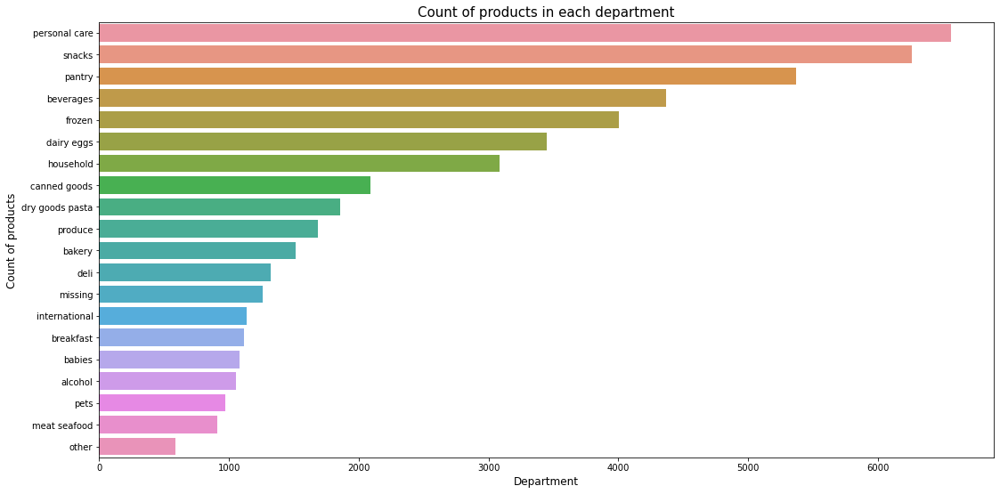

In [39]:
#checking to see number of products in each department again
plt.figure(figsize=(18,9))
sns.countplot(y='department_name', data=products_df, order = products_df['department_name'].value_counts().index)
plt.xticks(rotation=0)
plt.title("Count of products in each department", fontsize=15)
plt.tick_params(labelsize=10)
plt.xlabel("Department",fontsize=12)
plt.ylabel("Count of products",fontsize=12)
plt.show;

In [40]:
products_df['department_name'].value_counts()

personal care      6563
snacks             6264
pantry             5371
beverages          4365
frozen             4007
dairy eggs         3449
household          3085
canned goods       2092
dry goods pasta    1858
produce            1684
bakery             1516
deli               1322
missing            1258
international      1139
breakfast          1115
babies             1081
alcohol            1054
pets                972
meat seafood        907
other               586
Name: department_name, dtype: int64

Candy Chocolate other than the aisle named missing has the most products, next are ice cream ice, yogurt, vitamins supplements and chips pretzels are also pretty high in number of products. There seems to be an imbalanced number of products in each aisle. They may have lesser brands and variations as compared to products in aisles like Candy Chocolate, ice cream, yogurt, vitamins supplements and chips pretzels.

In [39]:
aisle_product = products_df.groupby(['aisle_name','product_name'], as_index=False).sum()
aisle_product.head()

,aisle_name,product_name,product_id,aisle_id,department_id,length_product_name
0,air fresheners candles,100% Beeswax Hand Dipped Tapers,5361,101,17,5
1,air fresheners candles,100% Pure & Certified Organic Lemon Oil,21171,101,17,7
2,air fresheners candles,100% Pure Cedarwood Essential Oil,18431,101,17,5
3,air fresheners candles,100% Pure Cinnamon Leaf Essential Oil,24868,101,17,6
4,air fresheners candles,100% Pure Clove Oil,34010,101,17,4


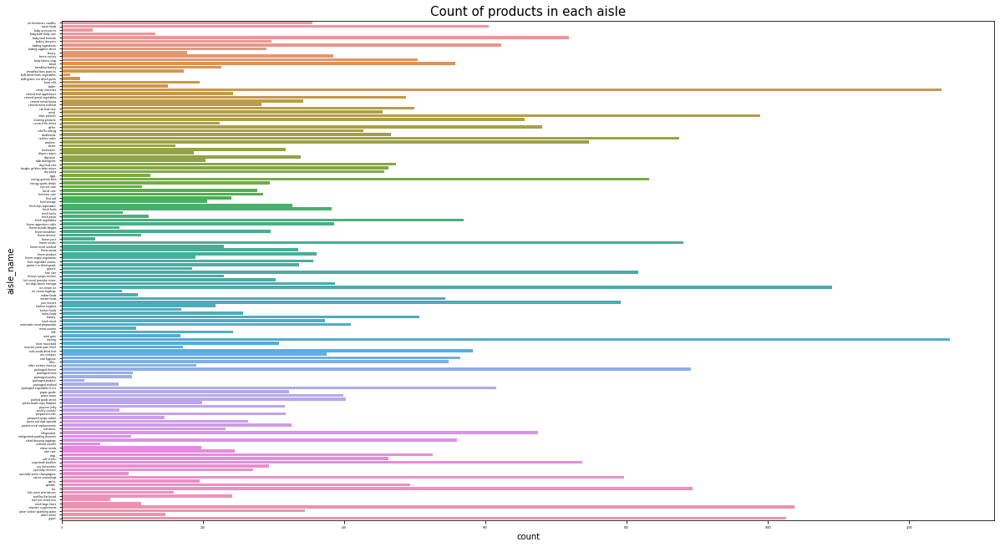

In [40]:
# can do this after merging the orders df to see the department that was purchased most
plt.figure(figsize=(20,11))
sns.countplot(y='aisle_name', data=aisle_product)
plt.xticks(rotation=0)
plt.title("Count of products in each aisle", fontsize=15)
plt.tick_params(labelsize=3)
plt.show;

## Initial Preprocessing

The product names seem clean except for some special characters like "&" and a few punctuations, apply the processing function defined below to get only words vocabulary in the corpus before feature extraction like CountVectorizer and Word2Vec, preprocessing like train_test_split, and modeling. As we want to keep full words to essentially identify each individual product, we shall not lemmatize the words.

In [41]:
# Preparation for preprocessing

# Lemmatize with POS Tag
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

# Initiate Lemmatizer
lemmatizer = WordNetLemmatizer()

# Set Stopwords
stops = set(stopwords.words('english'))

In [42]:
def processing(names):
    # Make lowercase
    names = names.lower()

    # Remove all punctuations and special characters
    names = re.sub(r"[^a-zA-Z]", " ", names)
    
    # Remove single or double words which could result from removal of punctuations
    names = re.sub(r"\b\w{1,2}\b", "", names)
    
     # Split into individual words.
    names = names.split()
    
    # Remove stopwords.
    meaningful_words = [w for w in names if w not in stops]
    
    # Lemmatization
    names = [lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in meaningful_words]
    #lemmatizer.lemmatize(w, get_wordnet_pos(w)) for w in nltk.word_tokenize(sentence)]
    
    return (" ".join(names))

In [43]:
products_df['product_name_words'] = products_df['product_name'].apply(processing)
products_df['product_name_words']

0                                 chocolate sandwich cooky
1                                              season salt
2                     robust golden unsweetened oolong tea
3        smart one classic favorite mini rigatoni vodka...
4                                green chile anytime sauce
5                                             dry nose oil
6                                pure coconut water orange
7                             cut russet potato steam mash
8                        light strawberry blueberry yogurt
9               sparkle orange juice prickly pear beverage
10                                       peach mango juice
11                              chocolate fudge layer cake
12                                       saline nasal mist
13                          fresh scent dishwasher cleaner
14                                   overnight diaper size
15                             mint chocolate flavor syrup
16                                         render duck f

We are looking at around 216,749 features.

In [44]:
products_df['product_name_words'].apply(lambda x: len(x.split(' '))).sum()

216749

In [45]:
# Save products df file as csv
products_df.to_csv('../datasets/products_df.csv')

## Comparison of products between classes

As the target classes are very imbalanced for both aisles and departments as seen previously, and since the distribution of products in the aisles and departments both do not follow a normal distribution and are skewed to the right, predicting which product belongs to which department would be more efficient as the product names between each aisle under a department are very similar as seen in the word cloud. Predicting the department would give the model more data(product name) to be trained with be better at predicting. The product names differs more between departments than aisles and the names are distinct enough to differentiate. Since our most immediate problem is to have all products mapped to their respective departments as accurately as possible so that users may search for products by department. If there are more data for products for it to be more distinctive in each aisles in the future, we can then predict from the department which of the products belong to which aisles in each department, this would then also further improve inventory organization and would then be able to to aisle-wise reporting. However, for now, predicting the department is sufficient.

/Users/becksphan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


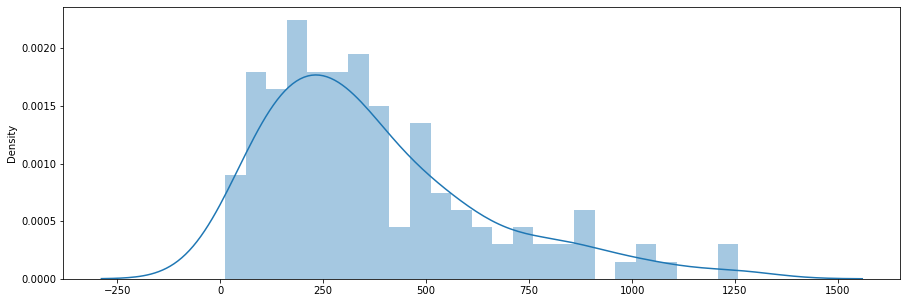

In [46]:
plt.figure(figsize=(15,5))
sns.distplot(x=products_df['aisle_name'].value_counts(), bins=25)
plt.show();

/Users/becksphan/opt/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



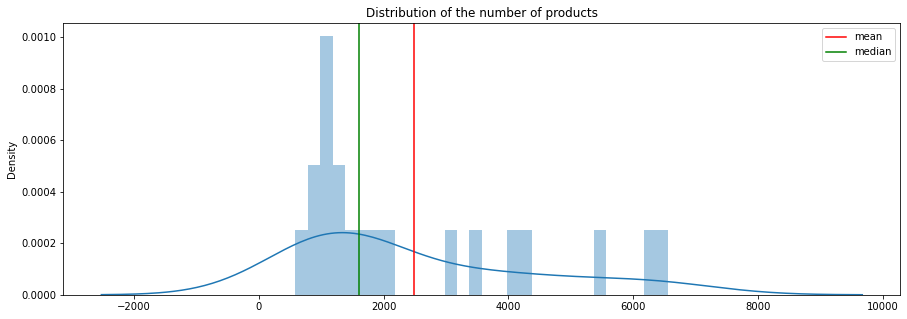

In [66]:
plt.figure(figsize=(15,5))
sns.distplot(x=products_df['department_name'].value_counts(), bins=30)
plt.axvline(x=products_df['department_name'].value_counts().mean(), c='r', label='mean')
plt.axvline(x=products_df['department_name'].value_counts().median(), c='g', label='median')
plt.title("Distribution of the number of products")
plt.legend()
plt.show();

In [48]:
# Looking at how similar each product name is in the beverages department
products_df[products_df['department_name']=='beverages']

,product_id,product_name,aisle_id,aisle_name,department_id,department_name,length_product_name,product_name_words
2,3,Robust Golden Unsweetened Oolong Tea,94,tea,7,beverages,5,robust golden unsweetened oolong tea
6,7,Pure Coconut Water With Orange,98,juice nectars,7,beverages,5,pure coconut water orange
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,water seltzer sparkling water,7,beverages,7,sparkle orange juice prickly pear beverage
10,11,Peach Mango Juice,31,refrigerated,7,beverages,3,peach mango juice
19,20,Pomegranate Cranberry & Aloe Vera Enrich Drink,98,juice nectars,7,beverages,7,pomegranate cranberry aloe vera enrich drink
38,39,Daily Tangerine Citrus Flavored Beverage,64,energy sports drinks,7,beverages,5,daily tangerine citrus flavor beverage
43,44,Sparkling Raspberry Seltzer,115,water seltzer sparkling water,7,beverages,3,sparkle raspberry seltzer
52,53,Whole Leaf Pure Aloe With Lemon Juice,98,juice nectars,7,beverages,7,whole leaf pure aloe lemon juice
68,69,Vanilla with Almond Milk Iced Coffee,26,coffee,7,beverages,6,vanilla almond milk iced coffee
72,73,Jasmine Tea Unfiltered Ginger Ale,77,soft drinks,7,beverages,5,jasmine tea unfiltered ginger ale


In [49]:
# Visualize how similar the words are in each aisle and how different in departments
def word_cloud(text, plot_title=None):

    wordcloud = WordCloud(
        stopwords=stops,
        width = 3000,
        height = 2000,
        max_words=500,
        background_color='black',
        colormap='Pastel1',
        random_state=42
    ).generate(text)
    plt.figure(figsize=(15, 7), facecolor='white')
    plt.imshow(wordcloud, interpolation="spline36")
    if plot_title:
        plt.title(plot_title, fontsize=15, pad=10)
    plt.axis("off")
    plt.show()

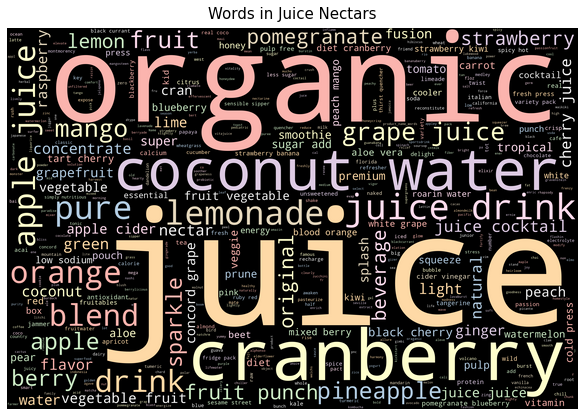

In [50]:
word_cloud(str(products_df[products_df.aisle_name == 'juice nectars']
               ['product_name_words']),
           plot_title='Words in Juice Nectars')

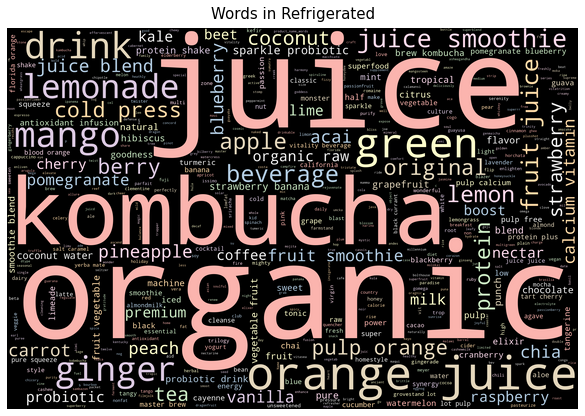

In [51]:
word_cloud(str(products_df[products_df.aisle_name == 'refrigerated']
               ['product_name_words']),
           plot_title='Words in Refrigerated')

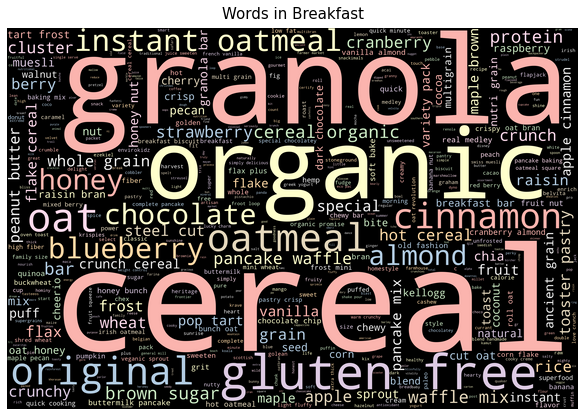

In [71]:
word_cloud(str(products_df[products_df.department_name == 'breakfast']
               ['product_name_words']),
           plot_title='Words in Breakfast')

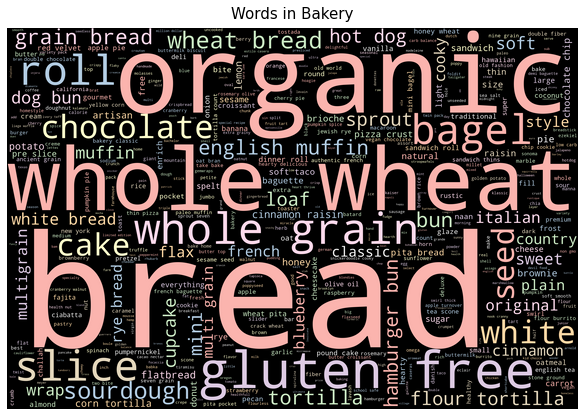

In [72]:
word_cloud(str(products_df[products_df.department_name == 'bakery']
               ['product_name_words']),
           plot_title='Words in Bakery')

In [104]:
# visualization for presentation
fig = px.treemap(products_df, 
                 path=['department_name', 'aisle_name', 'product_name'],
                 #values='product_name',
                 width=1100,
                 height=700
                 #color='NA_Sale'
                )

fig.update_traces(textinfo='label+value+percent parent', insidetextfont = {"size": 10, "color": "black"})

fig.show()

# html file
# Remove comment to export html
#plotly.offline.plot(fig, filename='../datasets/ProductsTreemap.html')

After cleaning, eda and some initial preprocessing, we have our final combined dataset for further preprocessing, feature extraction and modelling.